# Enviornment Setup

In [1]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [2]:
%cd drive/MyDrive/fall_2022/amenity_detection/

/content/drive/MyDrive/fall_2022/amenity_detection


In [3]:
%ls

data_collection/     output/        requirements.txt
data_collection.zip  preprocess.py  train_amenity_detection.ipynb
__MACOSX/            __pycache__/   train.py


In [4]:
#!unzip data_collection.zip

In [5]:
%pip install -q -r requirements.txt

     |████████████████████████████████| 723.9 MB 20 kB/s 
     |████████████████████████████████| 4.0 MB 847 kB/s 
     |████████████████████████████████| 6.7 MB 6.5 MB/s 
     |████████████████████████████████| 50 kB 6.1 MB/s 
     |████████████████████████████████| 42 kB 1.0 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.14.0 requires torch==1.13.0, but you have torch 1.4.0+cu100 which is incompatible.
torchaudio 0.13.0+cu116 requires torch==1.13.0, but you have torch 1.4.0+cu100 which is incompatible.
fastai 2.7.10 requires torch<1.14,>=1.7, but you have torch 1.4.0+cu100 which is incompatible.
fastai 2.7.10 requires torchvision>=0.8.2, but you have torchvision 0.5.0+cu100 which is incompatible.


# Training Detectron2 Model

In [ ]:
!nvidia-smi

Sat Dec 10 00:10:07 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   41C    P0    25W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!python3 preprocess.py

********************
Formatting input labels:

Using data_collection/labels/train-annotations-bbox.csv for annotations...
On dataset: data_collection/train/
Classes we're using:
Fireplace      711
Coffeemaker    323
Name: ClassName, dtype: int64
Total number of images: 918
100% 918/918 [00:23<00:00, 39.21it/s]

Saving labels to: data_collection/train/train_labels.json...
Showing an example:
[{'annotations': [{'bbox': [219.0, 0.0, 861.0, 679.0],
                   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
                   'category_id': 1}],
  'file_name': 'data_collection/train/070bad9f663015e5.jpg',
  'height': 768,
  'image_id': 525,
  'width': 1024}]

Using data_collection/labels/validation-annotations-bbox.csv for annotations...
On dataset: data_collection/validation/
Classes we're using:
Fireplace      41
Coffeemaker    21
Name: ClassName, dtype: int64
Total number of images: 61
100% 61/61 [00:01<00:00, 46.95it/s]

Saving labels to: data_collection/validation/valid_labels.json...
Show

In [ ]:
!python3 train.py




********************
Registering datasets:
Registering data_collection/train/
Registering data_collection/validation/



********************
Start Training:
Loading config /usr/local/lib/python3.8/dist-packages/detectron2/model_zoo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.
[12/10 00:24:32 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=

# inference pipeline

In [6]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger() # this logs Detectron2 information such as what the model is doing when it's training

# import some common libraries
import numpy as np
import pandas as pd
from tqdm import tqdm
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor # a default predictor class to make predictions on an image using a trained model
from detectron2.config import get_cfg # a config of "cfg" in Detectron2 is a series of instructions for building a model
from detectron2.utils.visualizer import Visualizer # a class to help visualize Detectron2 predictions on an image
from detectron2.data import MetadataCatalog # stores information about the model such as what the training/test data is, what the class names are

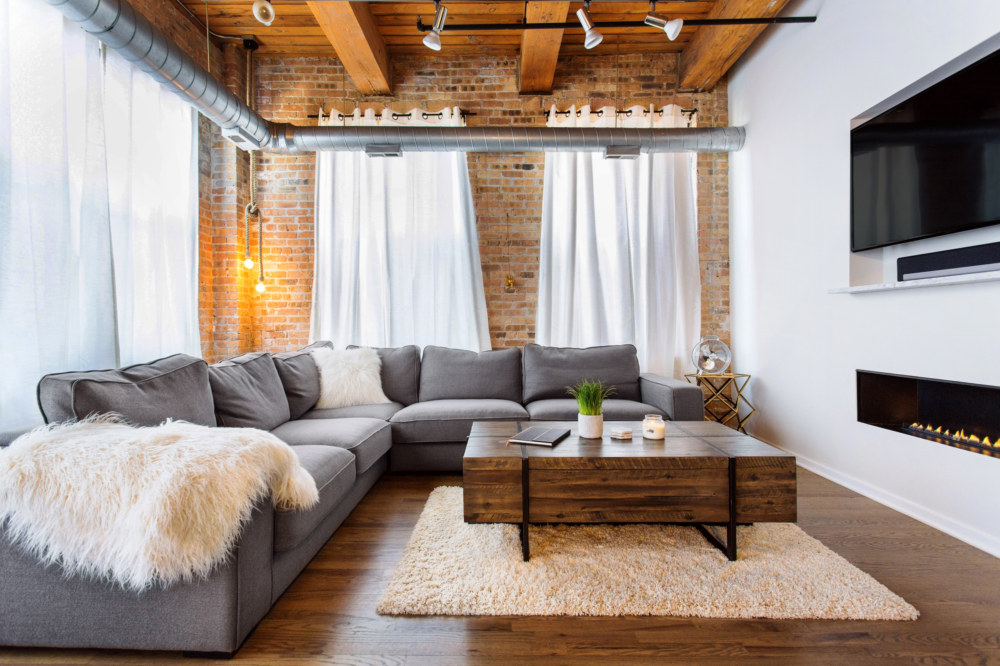

In [8]:
# Download and display example image and save it as demo.jpeg
img = cv2.imread("./demo.jpeg")
cv2_imshow(img)

In [26]:
# Target classes with spaces removed
target_classes = ['Bathtub',
                  'Bed',
                  'Billiard table',
                  'Ceiling fan',
                  'Coffeemaker',
                  'Couch',
                  'Countertop',
                  'Dishwasher',
                  'Fireplace',
                  'Fountain',
                  'Gas stove',
                  'Jacuzzi',
                  'Kitchen & dining room table',
                  'Microwave oven',
                  'Mirror',
                  'Oven',
                  'Pillow',
                  'Porch',
                  'Refrigerator',
                  'Shower',
                  'Sink',
                  'Sofa bed',
                  'Stairs',
                  'Swimming pool',
                  'Television',
                  'Toilet',
                  'Towel',
                  'Tree house',
                  'Washing machine',
                  'Wine rack']

idx2class = {i:cls for i, cls in enumerate(target_classes)}

print(len(target_classes))

30


In [11]:
# Setup a model config file (set of instructions for the model)
cfg = get_cfg()
cfg.merge_from_file("outputs/retinanet_model_final_config.yaml") # merge the config YAML file (a set of instructions on how to build a model)
cfg.MODEL.WEIGHTS = "outputs/retinanet_model_final.pth" # setup the model weights from the fully trained model

# Create a default Detectron2 predictor for making inference
predictor = DefaultPredictor(cfg)

# Make a prediction the example image from above
outputs = predictor(img)

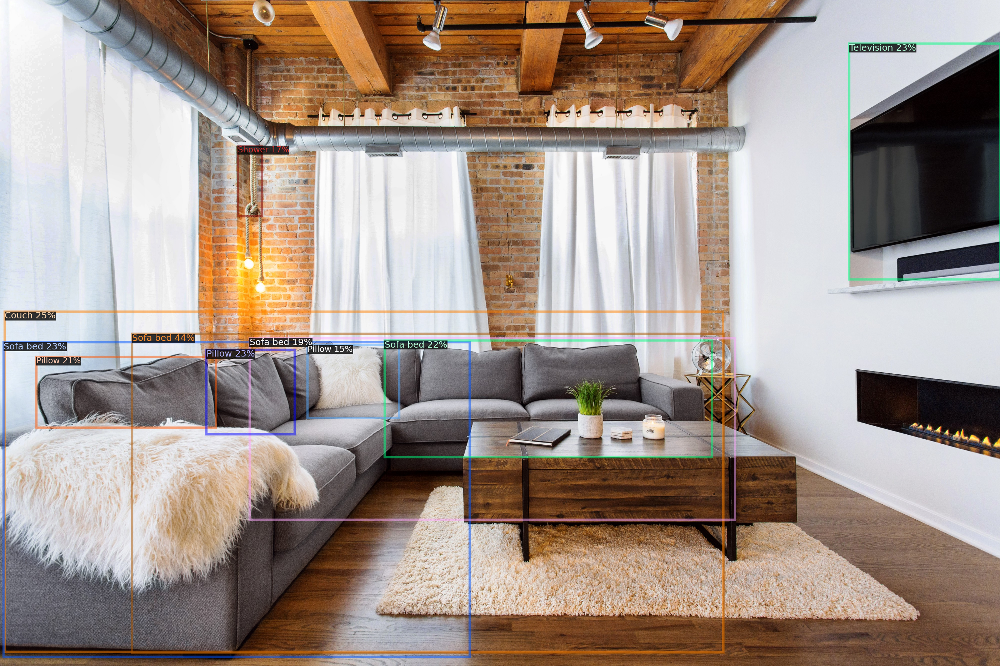

In [18]:
# Number of predicted amenities to draw on the target image
num_amenities = 10

# Set up a visulaizer
visualizer = Visualizer(img_rgb=img[:, :, ::-1], # we have to reverse the color order otherwise we'll get blue images (BGR -> RGB)
                        metadata=MetadataCatalog.get(cfg.DATASETS.TEST[0]).set(thing_classes=target_classes), # we tell the visualizer what classes we're drawing (from the target classes)
                        scale=0.7)

# Draw the models predictions on the target image
visualizer = visualizer.draw_instance_predictions(outputs["instances"][:num_amenities].to("cpu"))

# Display the image
cv2_imshow(visualizer.get_image()[:, :, ::-1])

In [34]:
# filter prediction by score
from pprint import pprint
preds = outputs["instances"].to("cpu")
for i in range(len(preds)):
    pred_class = preds[i].pred_classes.item()
    score = preds[i].scores.item()
    if score >= 0.10:
      print(f"Prediction: {idx2class[pred_class]}, Score: {score}")

Prediction: Sofa bed, Score: 0.44427064061164856
Prediction: Couch, Score: 0.24859701097011566
Prediction: Sofa bed, Score: 0.23136307299137115
Prediction: Pillow, Score: 0.23035971820354462
Prediction: Television, Score: 0.22675630450248718
Prediction: Sofa bed, Score: 0.22423897683620453
Prediction: Pillow, Score: 0.20801791548728943
Prediction: Sofa bed, Score: 0.191885307431221
Prediction: Shower, Score: 0.17207485437393188
Prediction: Pillow, Score: 0.1483437567949295
Prediction: Fireplace, Score: 0.1460980772972107
Prediction: Couch, Score: 0.14046524465084076
Prediction: Couch, Score: 0.13907523453235626
Prediction: Pillow, Score: 0.13886260986328125
Prediction: Mirror, Score: 0.13439643383026123
Prediction: Sofa bed, Score: 0.13236509263515472
Prediction: Television, Score: 0.12772417068481445
Prediction: Mirror, Score: 0.12122467905282974
Prediction: Television, Score: 0.1155499592423439
Prediction: Couch, Score: 0.1074705421924591
